# Samia ABRIK
---

# PW 1 - Practical work on SAR imaging : introduction to SAR data and interferometric processing
The aim of this PW is to get familiar with SAR data (high dynamic of the images, complex data with ampltidue and phase). After a first part on the visualization of such data and the understanding of the image content, the second part is dedicated to the processing of phase and interferometric data.

## 1. Analysis of a series of SAR images
In this part, we will have a look at a temporal series of 25 SAR images acquired [from 2015-10-06 to 2016-11-05](https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/PileLely_3072x1024RECALZ4.label), with a time delay of approximately 12 days.

By making use of these SAR images, we will see the main differences with respect to conventional natural images and develop some simple tools to visualize an image, interpret it and detect temporal changes.

In [1]:
# !wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath
from google_drive_downloader import GoogleDriveDownloader as gdd


plt.rcParams['figure.figsize'] = [4, 4]
plt.rcParams['figure.max_open_warning'] = 15

In [2]:
# Download of the time series
webpage = 'https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/'
imagename = 'lely_tuple_multitemp.IMA'
imaslc = mvalab.imz2mat(webpage+imagename) # complex image

time_series_amp = np.abs(imaslc[0]) # taking an array of shape [n_rows,n_columns,n_dates] in amplitude format

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


### Question 1.1: display a SAR image
SAR images have a long-tailed distribution, making its dynamic range to be wide. Plot the image with matplotlib. What do you see?

It looks like an optical image with a low exposition and a low contrast. How can you improve the contrast of a SAR image, in order to have a more pleasant visualization?
Implement a function to plot a SAR image and comment the results obtained.

A usual way to do this, is the saturate all the values above a certain threshold (often chosen as the mean + 3 times the standard deviation of the image) and do a linear stretching for the other values.
Explain the effect of this processing and what you see in the resulting image.

### Answer 1.1
When we plot a SAR image using matplotlib, we see an image that appears dark and lacks contrast. This is due to the fact that SAR images often have a long-tailed distribution, meaning that a majority of the pixel values are low, while a small number of pixel values are very high. This wide dynamic range can make it difficult to visualize the details in the image.

To improve the contrast of SAR images, we can perform a process involving setting a threshold value, and then scaling the pixel values that fall below this threshold to a smaller range. Any pixel values that are above the threshold are set to the maximum value in the range.

The effect of this processing is to enhance the constrast in the image, making it easier to see the details and features.

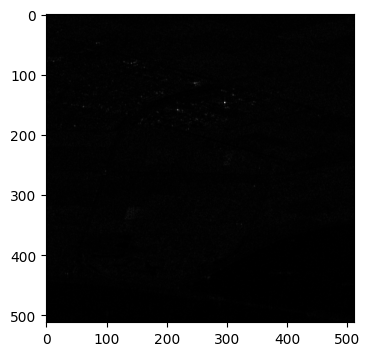

In [3]:
plt.figure()
plt.imshow(time_series_amp[:,:,0],cmap='gray')
plt.show()

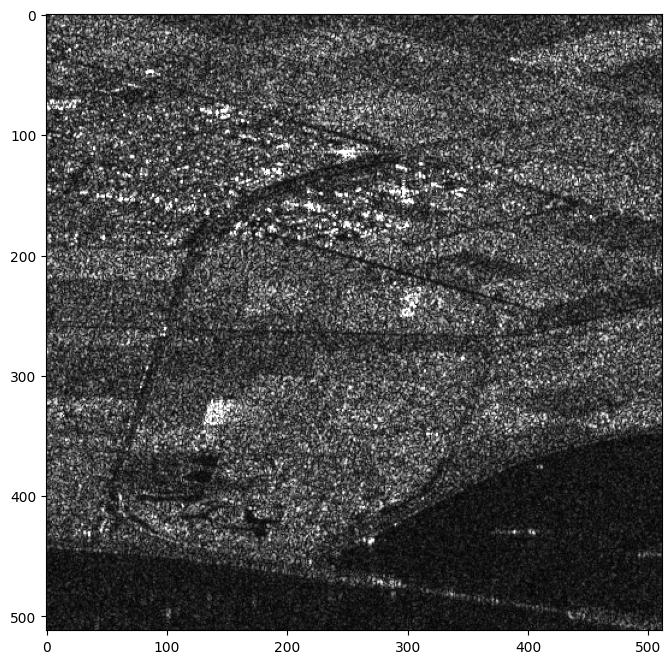

In [6]:
# implement the following function to plot a SAR image
# you can use a threshold as mean + 3 sigma
# and the np.clip function

def plot_sar(ima):
  plt.figure(figsize=(8,8))
  t = np.mean(ima) + 3*np.std(ima) # choose the appropriate theshold
  plt.imshow( np.clip(ima, 0, t),cmap='gray') # display the saturated image
  plt.show()

plot_sar(time_series_amp[:,:,0])

### Question 1.2: Image orientation
Is the image in the correct geographic orientation?
Apply the proper flipping if necessary.

To see the corresponding optical image and find the correct flipping, you can have a look on Google Maps at [this location](https://goo.gl/maps/LQcd3Uz9U7qCoRrH6).

### Answer 1.2

No, the image is in the wrong geographic orientation. We should flip it with respect to the horizontal axe.

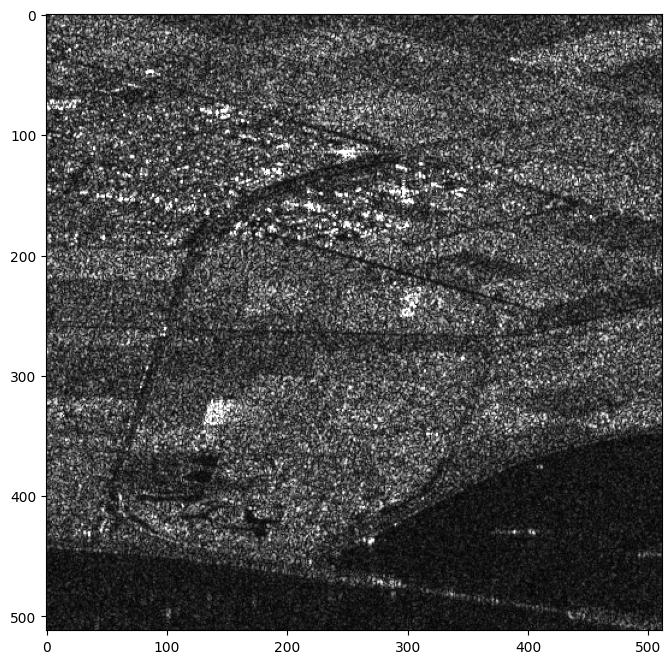

In [7]:
plot_sar(time_series_amp[:,:,0])

In [8]:
time_series_flipped = np.copy(time_series_amp)
time_series_flipped = np.flip(time_series_flipped, axis=0) # apply flipping if necessary using np.flip 

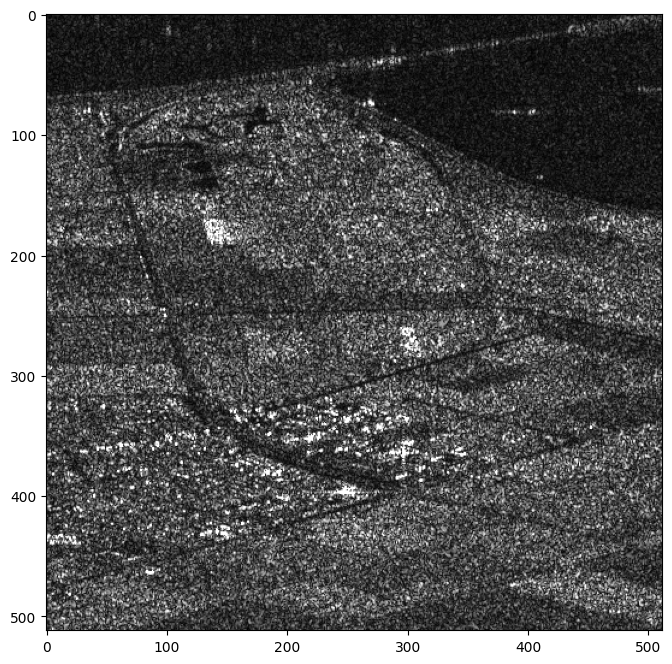

In [9]:
plot_sar(time_series_flipped[:,:,0])

### Question 1.3: Interpretation of a SAR image
The image contains
- an urban area,
- agricultural fields,
- water

Explain the appearence of these objects in the SAR image.

### Answer 1.3
- urban area: bright areas ( since there is a lot of texture, it reflects a lot of recieved waves from the sensor )
- agricultural fields: less bright than the urban areas ( due to complex interactions between waves at ground level )
- water: dark areas ( since water is a flat surface it reflects light in the opposite direction of the sensor (Snell Descartes) )

### Question 1.4: Multitemporal analysis and change detection
To detect changes occurring between three dates, images can be displayed in a false colour representation, each date being one channel of a RGB image. Implement the function ```plot_changes```.

Then, choose three dates from the multitemporal stack (indexes from 0 to 24). From the false colour representation, can you tell when a particular change has occurred? Explain how you can interpret it.

### Answer 1.4
In the false colour representation, areas that appear red in the image correspond to changes that occurred between the first and second dates, areas that appear green correspond to changes that occurred between the second and third dates, and areas that appear blue correspond to changes that occurred between the first and third dates.

We notice big changes in the agricultural areas and also we can see boats that moved in the coast. No big changes in the urban areas, and water of course.

In [12]:
def plot_changes(im1,im2,im3):
    t1 = np.mean(im1) + 3*np.std(im1) 
    t2 = np.mean(im2) + 3*np.std(im2) 
    t3 = np.mean(im3) + 3*np.std(im3) 
    threshold = np.mean([t1, t2,  t3]) # choose a unique threshold for the three images
    # apply thresholding and shrinking of each image between [0;1] for RGB data
    im1 = np.clip(im1,0,threshold)
    im1 = im1/threshold
    im2 = np.clip(im2,0,threshold)
    im2 = im2/threshold
    im3 = np.clip(im3,0,threshold)
    im3 = im3/threshold
    image = np.stack((im1,im2,im3),axis=2) # create a false RGB image by stacking the three dates
    plt.figure(figsize=(8,8))
    plt.imshow(image)
    plt.show()

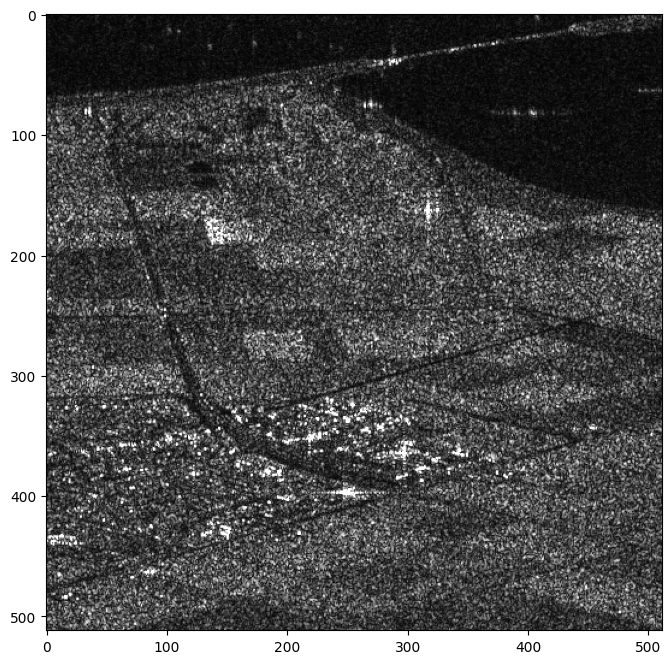

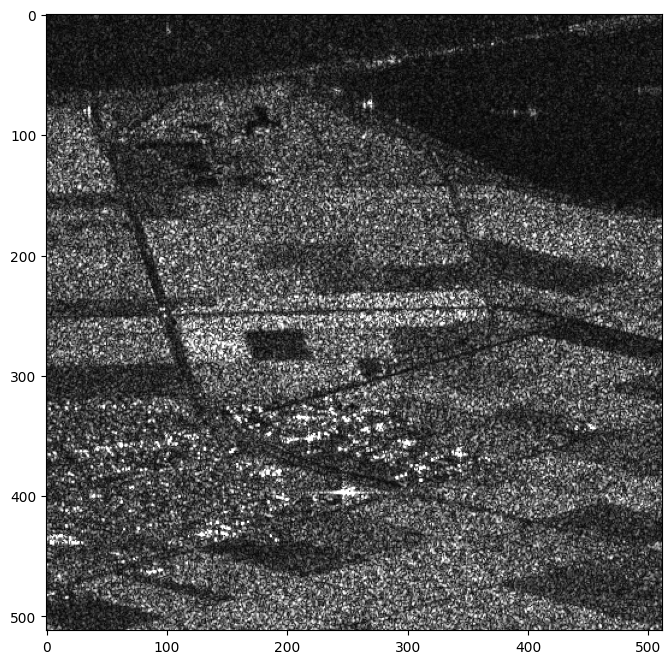

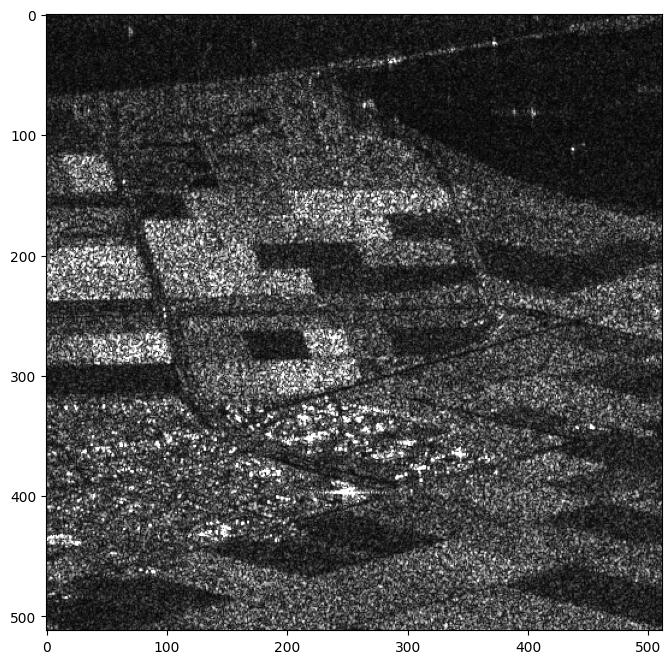

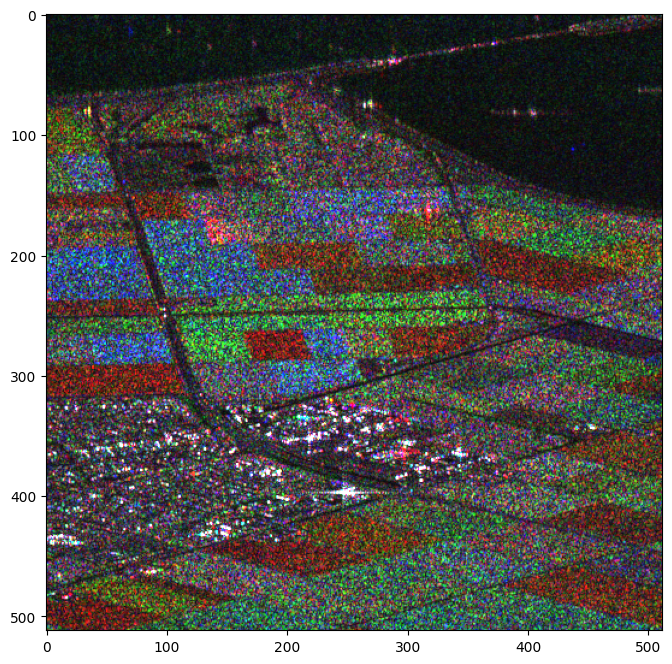

In [13]:
# choose three dates
idx1 = 1
idx2 = 10
idx3 = 15
im1 = time_series_flipped[:,:,idx1]
im2 = time_series_flipped[:,:,idx2]
im3 = time_series_flipped[:,:,idx3]

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

### Question 1.5: Create an image with isotropic pixels
The image pixels have the following size: $13.86[m]\times 2.3[m]$ in azimuth $\times$ range (approximately, pixel height is 5 times greater than pixel length). How can you create an image with approximately squared pixels?

PS : the range drection was the horizontal direction and the azimuth direction the vertical direction in the original image (before any flipping)

### Answer 1.5
We can filter the image using a $mask = [ 1 1 1 1 1]$ that averages the pixel values in the azimuth direction. ( we use a mask of length 5 since the pixel height is 5 times greater than the pixel length). Then, we resample the image to obtain a pixel size that is approximately equal in the azimuth and range direction. This can be done by selecting every 5th pixel in the azimuth

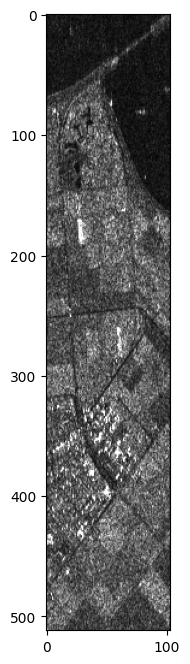

In [14]:
ima_tmp = time_series_flipped[:,:,0]

mask = np.ones((1,5)) # create a mask
ima_filtered = scipy.signal.convolve2d(ima_tmp,mask,mode='same') # filter the image with the appropriate mask
ima_squared_pixels = ima_filtered[:,::5] # resample the filtered image
plot_sar(ima_squared_pixels)

## 2. Analysis of TerraSAR-X images acquired over the Paris area
In this part we will use an image of TerraSAR-X sensor (metric resolution) of Paris.
This is a temporal stack, you can choose the date you want.
(The questions are similar to the previous ones and will not be done during the PW but later as personal work).

imz2mat : version janvier 2018.  Fichier à ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.dim
Multitemporal image 21 data
Fichiers PC
Image  complex short
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:21
Debug 2 2 2048
2 2048 <h
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


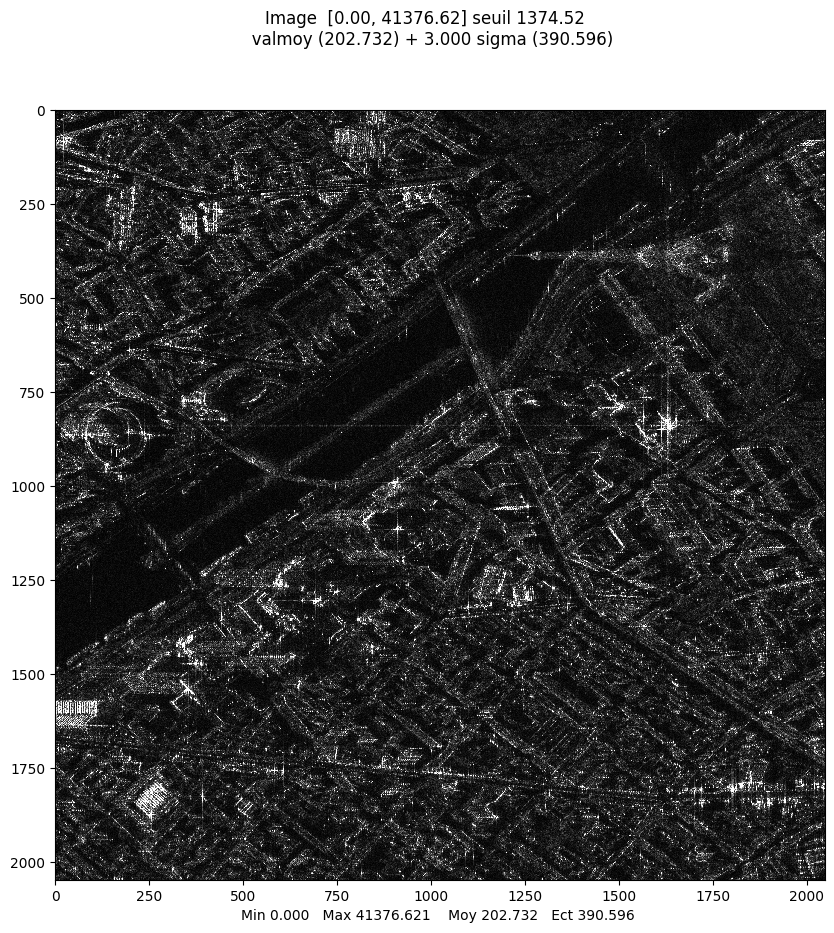

array([[ 58.30951895,  59.07622195, 145.77379737, ...,  22.84731932,
         42.05948169,   5.83095189],
       [ 90.00555538,  64.77653896, 117.08543889, ...,  41.76122604,
         17.80449381,   2.        ],
       [259.49373788, 153.83432647,  92.00543462, ..., 129.18978288,
         80.80222769,  43.18564576],
       ...,
       [132.37069162, 283.06359709, 409.33238328, ...,  88.05112151,
         62.03224968,  11.04536102],
       [ 36.76955262, 239.15058018, 382.41469637, ...,  11.        ,
         44.72135955,  10.        ],
       [100.56838469, 189.78145326, 234.04700383, ...,  17.49285568,
         94.42986816,   8.60232527]])

In [16]:
# 21 images from TerraSAR-X between 2009-01-24 and 2010-11-26
webpage='https://perso.telecom-paristech.fr/tupin/TPSAR/paris/'
image='PileiEiffeljavelRECALZ4RECSP.IMA'
im_slc_tsx_paris_liste=mvalab.imz2mat(webpage+image);
im_slc_tsx_paris = im_slc_tsx_paris_liste[0][:,:,0]
plt.rcParams['figure.figsize'] = [10, 10]
mvalab.visusar(np.abs(im_slc_tsx_paris))

### Question 2.1: interpretation
Check that you recognize the main buildings on this image.
What is the position of the track of the sensor relatively to this image ?

Explain the appearence of the following buildings in the amplitude image : Eiffel Tower, Maison de la radio, Pont de Bir-Hakeim (you can use a [satellite optic image on googlemaps](https://www.google.com/maps/place/Eiffel+Tower/@48.851143,2.2797819,447m/data=!3m1!1e3!4m5!3m4!1s0x47e66e2964e34e2d:0x8ddca9ee380ef7e0!8m2!3d48.8583701!4d2.2944813) to help you).



### Answer 2.1
We recognize some buildings like the Eiffel Tower, Maison de la radio, le pont de Bir-Hakeim, and also la Seine river in pure black.

From the way the Eiffel Tower is shown, we conclude that the sensor is in the left of the image.

### Question 2.2: change detection
Identify and explain the appearence of some changing objects on Paris.

### Answer 2.2
There isn't many remarkable changes, but we can see some small colored areas corresponding to either moving cars or ferrys.

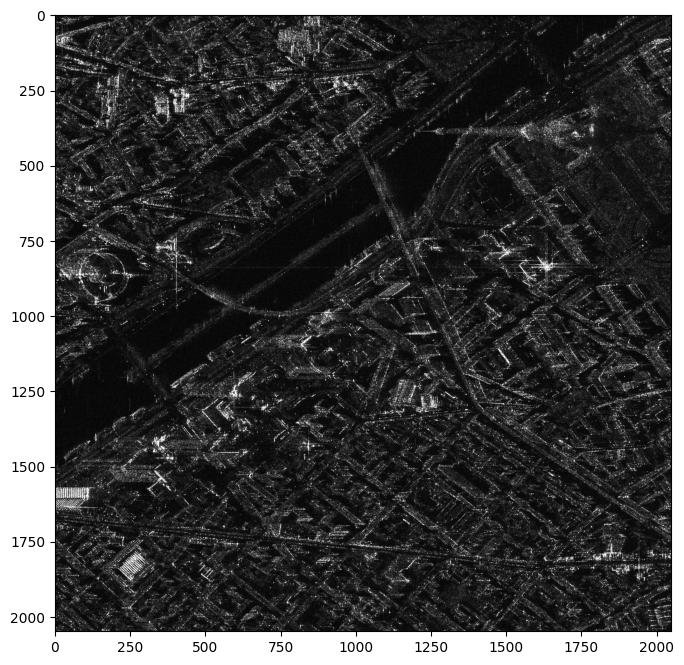

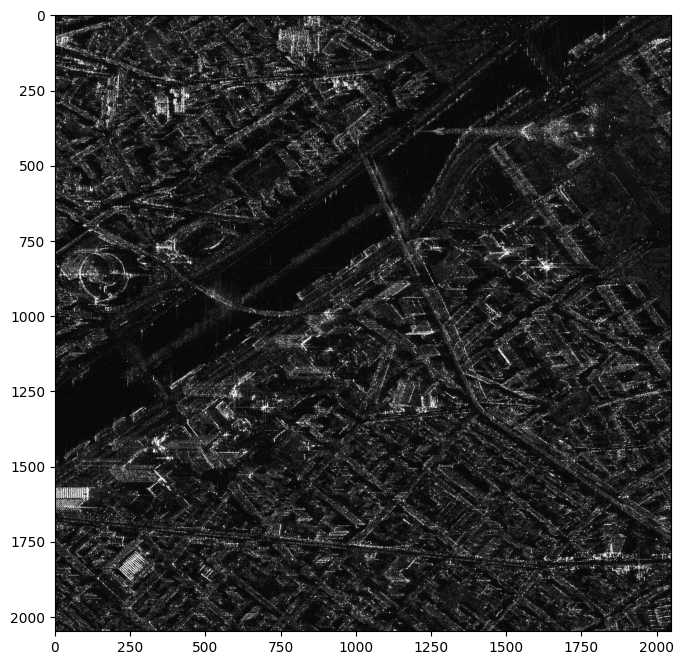

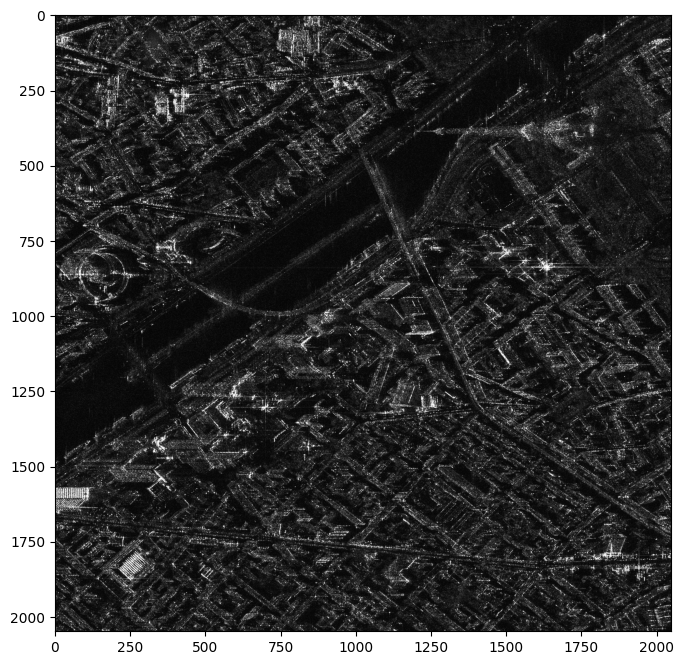

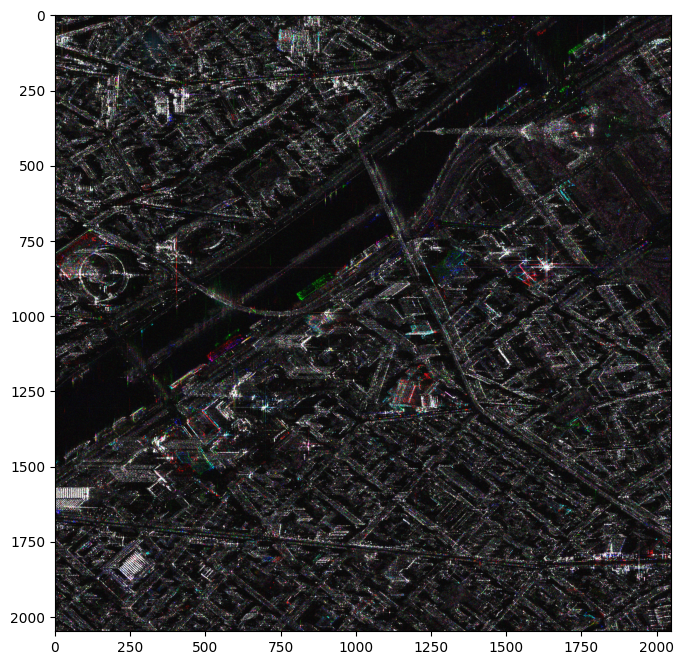

In [17]:
idx1 = 1
idx2 = 10
idx3 = 15
im1 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx1])
im2 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx2])
im3 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx3])

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

## 3. SAR interferometry
In this part, the objective is to see the content of the phase of a SAR image and to do a simple processing chain to obtain an interferogram with topographic fringes.
You will be able to have a look to the optical image [on this link](https://g.page/ParcoEtna?share)

'wget' is not recognized as an internal or external command,
operable program or batch file.
'wget' is not recognized as an internal or external command,
operable program or batch file.


Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


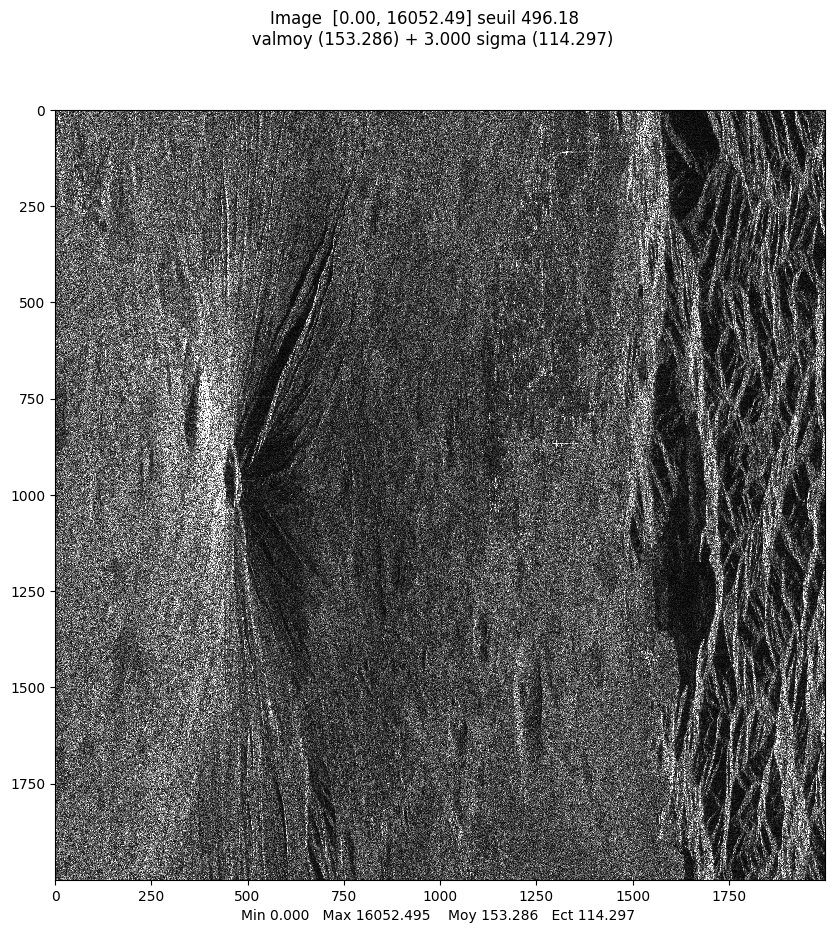

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


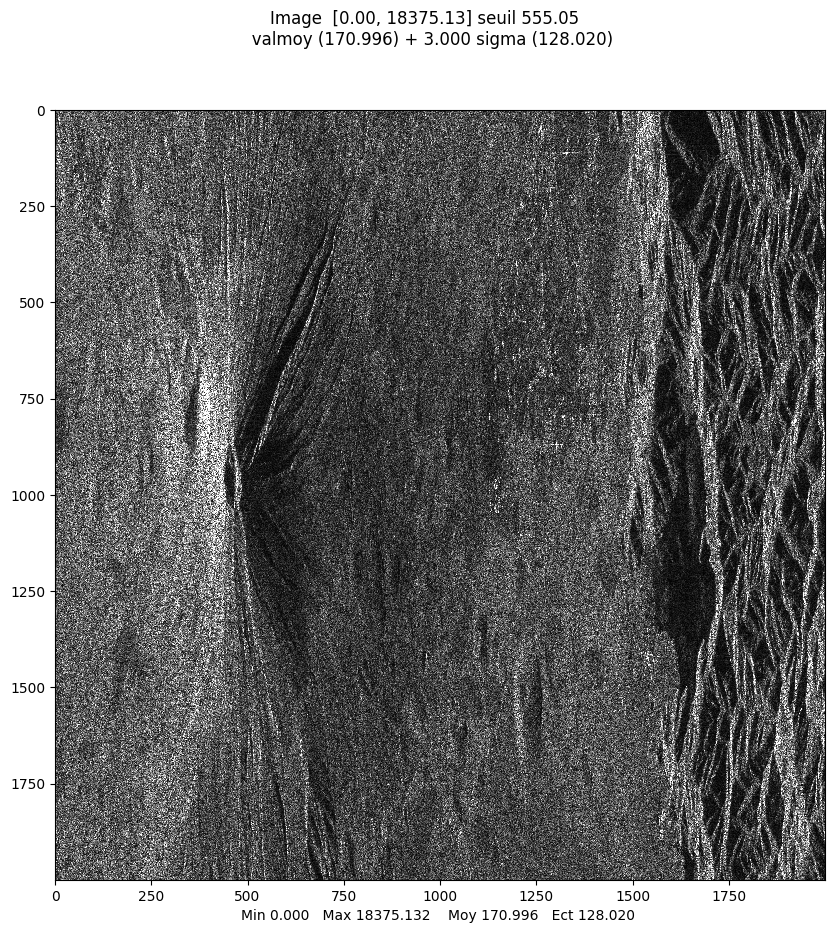

array([[246.54614173, 283.98943642,  94.86832981, ..., 499.65287951,
         82.00609733, 555.05417664],
       [257.41989045, 199.25109786, 141.73566947, ..., 399.60605601,
         55.        , 385.81083448],
       [146.10954794,  62.03224968,  77.79460136, ...,  67.08203932,
        205.24375752, 155.95512175],
       ...,
       [254.2380774 , 237.76669237, 199.58206332, ...,  72.9451849 ,
         43.68065934,  74.43117626],
       [182.00274723, 226.37358503, 142.5622671 , ...,  91.58602513,
         45.48626166,  31.        ],
       [ 57.97413216, 237.76038358, 143.58969322, ...,  72.99315036,
         74.72616677,  77.1038261 ]])

In [19]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
imageM='./Master.mat'
imageS='./Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

imamaitre = imamaitre[0][1000:3000,:]
imaslave = imaslave[0][1000:3000,:]
ncolonnes=imamaitre.shape[1]
nlignes=imamaitre.shape[0]

#%%
plt.rcParams['figure.figsize'] = [10, 10]
mvalab.visusar(imamaitre)
mvalab.visusar(imaslave)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


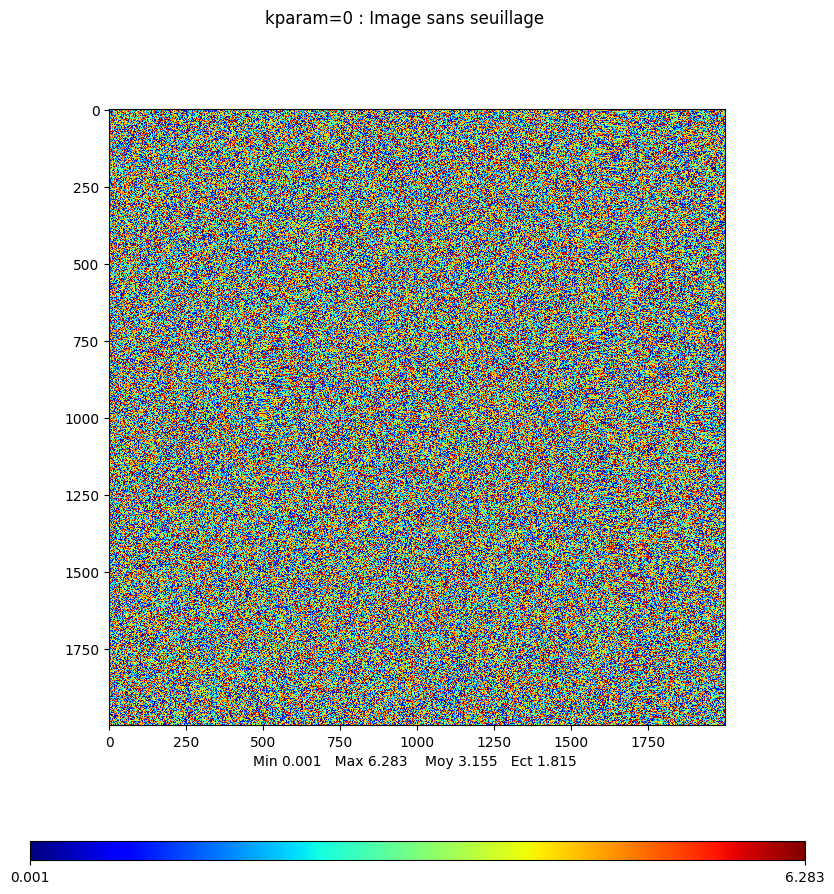

array([[6.12759048, 4.74305421, 4.41221781, ..., 1.9513027 , 5.200422  ,
        6.0785435 ],
       [0.78539816, 0.03569911, 0.609806  , ..., 2.89193238, 2.15744024,
        1.01336524],
       [1.61077501, 2.02577363, 2.68329259, ..., 5.24820022, 4.04275003,
        3.41047529],
       ...,
       [1.85360554, 1.2715139 , 1.81236203, ..., 3.18807078, 5.0244311 ,
        5.62461942],
       [4.13432394, 2.56347441, 0.83571537, ..., 0.14888995, 0.54937448,
        1.62479783],
       [0.04521802, 3.98984498, 3.34584682, ..., 2.89161403, 0.70862627,
        5.60998996]])

In [20]:
# display the phase of one image
#mvalab.visuinterfero uses an adapted lut to see the phase of an image
mvalab.visuinterfero(np.angle(imamaitre)+math.pi,0)


### Question 3.1
Do you recognize the area in the amplitude images ? Give a short interpretation. Visualize the phase of an image. Do you see any useful information?

### Answer 3.1
In the amplitude images, we recognize the two sides of the volcano (bright and dark part), and from it we can conclude that the sensor is in the left of the image.

In the phase image, we cannot recognize any interpretable or useful information.

### Question 3.2
Compute the interferogram by computing $z_1.z_2^*$ and display the phase. Do you see any structured pattern ?

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


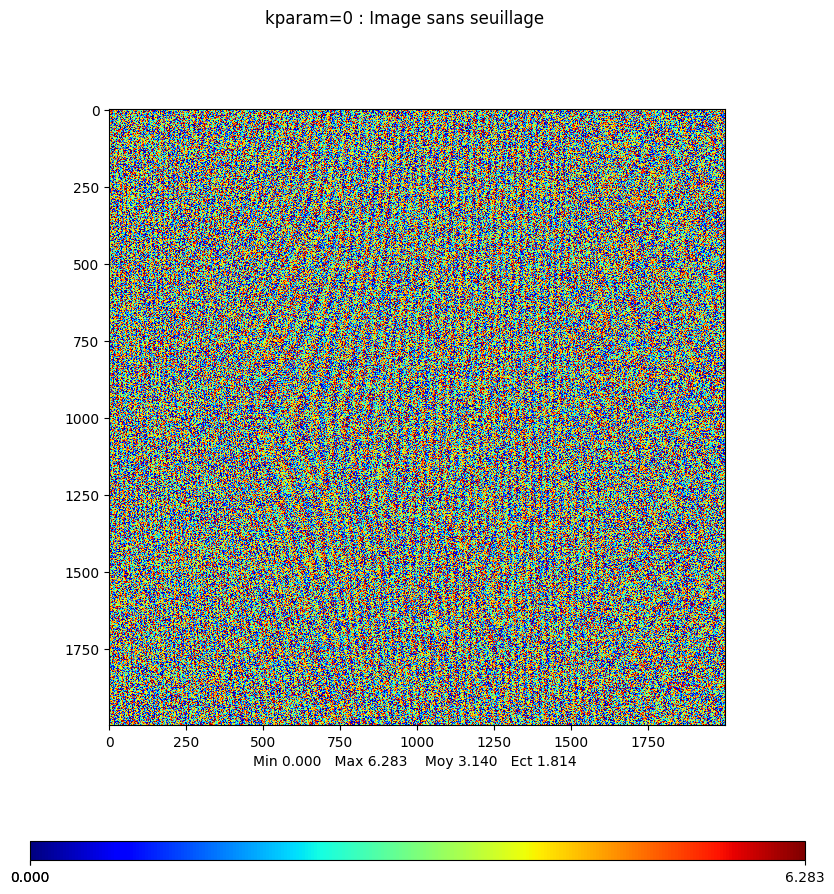

array([[2.55500648, 1.78918891, 1.87616982, ..., 3.10590681, 0.4758385 ,
        3.39207593],
       [0.89047844, 1.22598906, 3.15165491, ..., 1.95913171, 1.51393913,
        2.64900559],
       [5.98842716, 1.99352675, 3.45051094, ..., 4.1410515 , 4.09149189,
        4.72851706],
       ...,
       [0.90900284, 0.57246763, 6.18240116, ..., 0.54691894, 1.60453879,
        4.58963434],
       [0.98723683, 0.62201552, 4.9523198 , ..., 2.27134126, 1.53826569,
        3.19559415],
       [1.87772785, 0.76825464, 6.18330824, ..., 2.72646535, 5.6919621 ,
        4.09109503]])

In [22]:
raw_interf = imamaitre*np.conj(imaslave) # compute z1.z2*
plt.rcParams['figure.figsize'] = [10, 10]
mvalab.visuinterfero(np.angle(raw_interf)+math.pi,0) # diplay the phase

### Answer 3.2
We see a vertical fringe pattern in the middle of the image, but in the sides it's very noisy. We can also barely see the mountain shape.

### Question 3.3: Registration of the two images
To compute an interferogram, the following steps have to be applied :
- registration of the two images (only a translation is searched)
- suppression of the vertical fringe pattern
- filtering to improve the phase information.

Using the knowledge acquired on previous courses, propose a method and apply it to do the registration between the two images. Complete the code below.

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


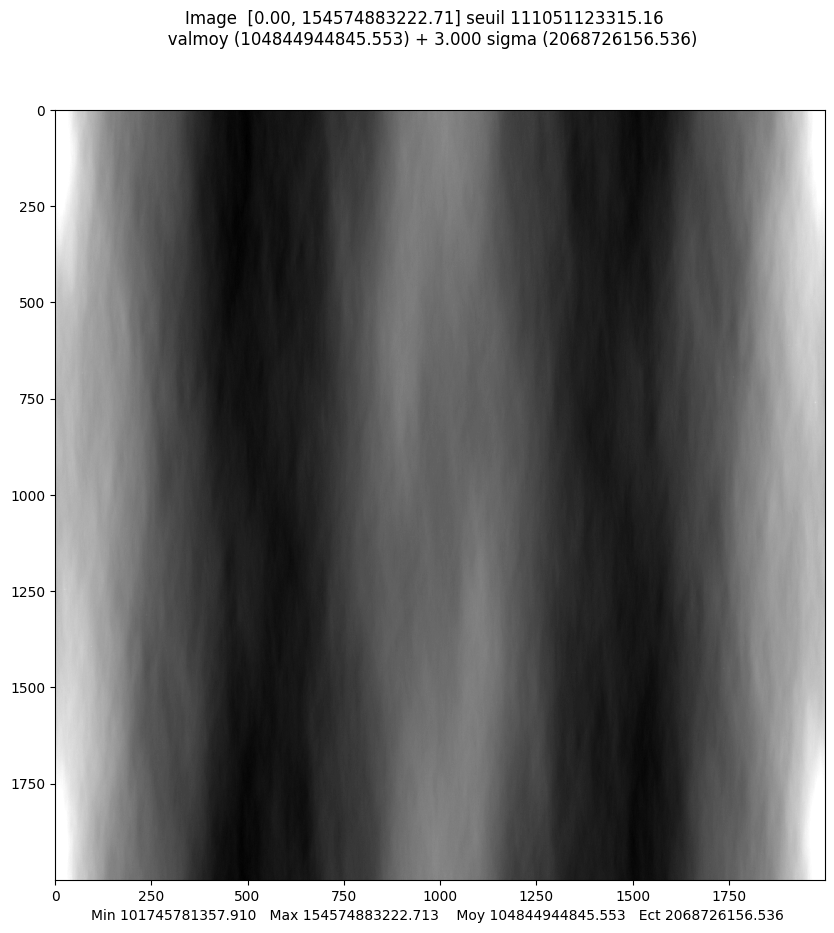

(2, 0)
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


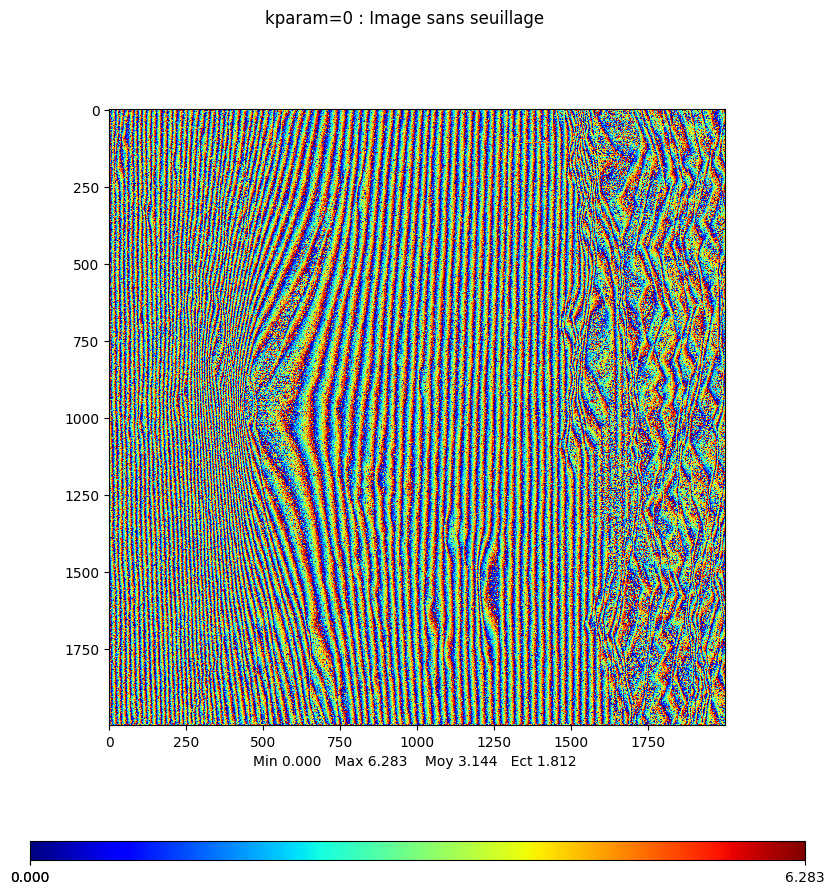

array([[4.22205732, 4.71080733, 5.17943616, ..., 0.84415399, 5.24916385,
        1.11339996],
       [4.88475065, 4.36758172, 4.71439299, ..., 5.99860473, 6.17553618,
        1.2324965 ],
       [4.49176528, 4.6466379 , 4.50604421, ..., 2.97654948, 0.68942589,
        1.65815508],
       ...,
       [3.68611537, 4.33310887, 4.64982345, ..., 3.02292211, 3.72458163,
        4.1057245 ],
       [0.56173994, 5.89279441, 4.58285269, ..., 1.30349405, 2.10797629,
        5.22151557],
       [0.1502983 , 5.18013493, 5.88769572, ..., 1.95881336, 0.06512516,
        0.96244501]])

In [23]:
# propose a method to extract the shift along the two axes
# to compute the correlation efficiently you can use the FFT

# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT
imacorfft = np.fft.fft2(np.abs(imamaitre)).conj()*np.fft.fft2(np.abs(imaslave))
imacor = np.fft.ifft2(imacorfft)

#visualize the correlation image (maximum gives the translation value)
mvalab.visusar(imacor)
# you can use np.argmax and np.unravel_index
ishift = np.unravel_index(np.argmax(imacor), imacor.shape)
print(ishift)

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave, -ishift[0], axis=0)
imaslaveroll=np.roll(imaslaveroll, -ishift[1], axis=1)

# compute the interferogram and plot the interferometric phase
interfero = imamaitre * np.conj(imaslaveroll) # to be completed
plt.rcParams['figure.figsize'] = [10, 10]
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Question 3.4
What is the shift between the two images ? Which pattern do you see in the resulting fringes when computing the interferogram after the registration ?

### Answer 3.4
The shift between twp images represents the amount of translation that needs to be applied to one of the images to align it with the other. We got ishift = (2, 0), so the slave image needs to be shifted 2 pixels down to align it with the master image.
The resulting fringes are vertical and wider than before.

### Question 3.5: Suppression of the orbital fringes
To obtain the useful information about the topography the so-called orbital fringes have to be suppressed. It can be done by using the sensor parameters but in this practical work we propose to use a signal processing method.
How can you detect a pure sinusoid in a signal ? (it is the case of the pattern we would like to suppress in the horizontal direction). Compute the frequency of this pattern and use it to suppress it in the registered secondary image.

Which frequency did you obtain ? Is it the same for all the considered lines ? What do you see in the resulting interferogram after correction ?

C:\Users\m\AppData\Roaming\Python\Python311\site-packages\numpy\ma\core.py:3387: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
C:\Users\m\AppData\Roaming\Python\Python311\site-packages\matplotlib\cbook\__init__.py:1340: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


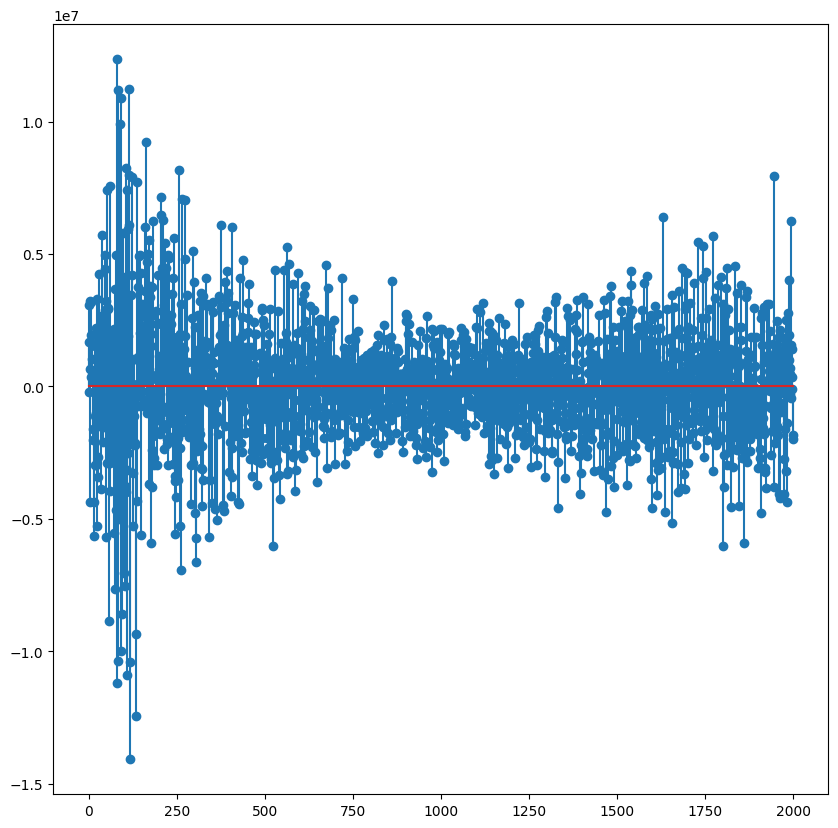

(87,)
Frequency : Number of occurences
[[  36    1]
 [  52    1]
 [  72    2]
 [  74    1]
 [  75    2]
 [  76    4]
 [  77    4]
 [  78   26]
 [  79   19]
 [  80   62]
 [  81  175]
 [  82  160]
 [  83  116]
 [  84  120]
 [  85   44]
 [  86   59]
 [  87   58]
 [  88   41]
 [  89   10]
 [  90    2]
 [  91    8]
 [  92   15]
 [  93    1]
 [  99    1]
 [ 100    3]
 [ 101    2]
 [ 102    1]
 [ 104   10]
 [ 105    4]
 [ 106    2]
 [ 109    2]
 [ 112    3]
 [ 117    7]
 [ 118    2]
 [ 119    1]
 [ 120   12]
 [ 121    9]
 [ 122    8]
 [ 123   11]
 [ 124    2]
 [ 125    8]
 [ 126   15]
 [ 127    1]
 [ 128   22]
 [ 129    6]
 [ 130   19]
 [ 131   14]
 [ 132   26]
 [ 133   30]
 [ 134   54]
 [ 135   30]
 [ 136   29]
 [ 137   43]
 [ 138   24]
 [ 139   21]
 [ 140   25]
 [ 141   15]
 [ 142    8]
 [ 143    7]
 [ 144   16]
 [ 145   17]
 [ 146    6]
 [ 147   10]
 [ 148    4]
 [ 149    1]
 [ 150   13]
 [ 151   13]
 [ 152    6]
 [ 153    5]
 [ 154    3]
 [ 155    3]
 [ 156    5]
 [ 157   11]
 [ 158   10]

In [24]:
# compute the main frequency of the pattern by choosing a line in the image and using the FFT
fftfringe = np.fft.fft(interfero[61,:])
plt.figure()
plt.stem(fftfringe)
plt.show()

freq = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)
print(freq)

freqs = []
for line in range(interfero.shape[0]):
    fftfringe = np.fft.fft(interfero[line,:])
    f = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)
    freqs.append(f)
unique, counts = np.unique(freqs, return_counts=True)
print("Frequency : Number of occurences")
print(np.asarray((unique, counts)).T)

### Answer 3.5a
We can use a Fourier transform to detect the most important frequency. We can see that the most recurrent frequency is 81. It changes slightly between lines.

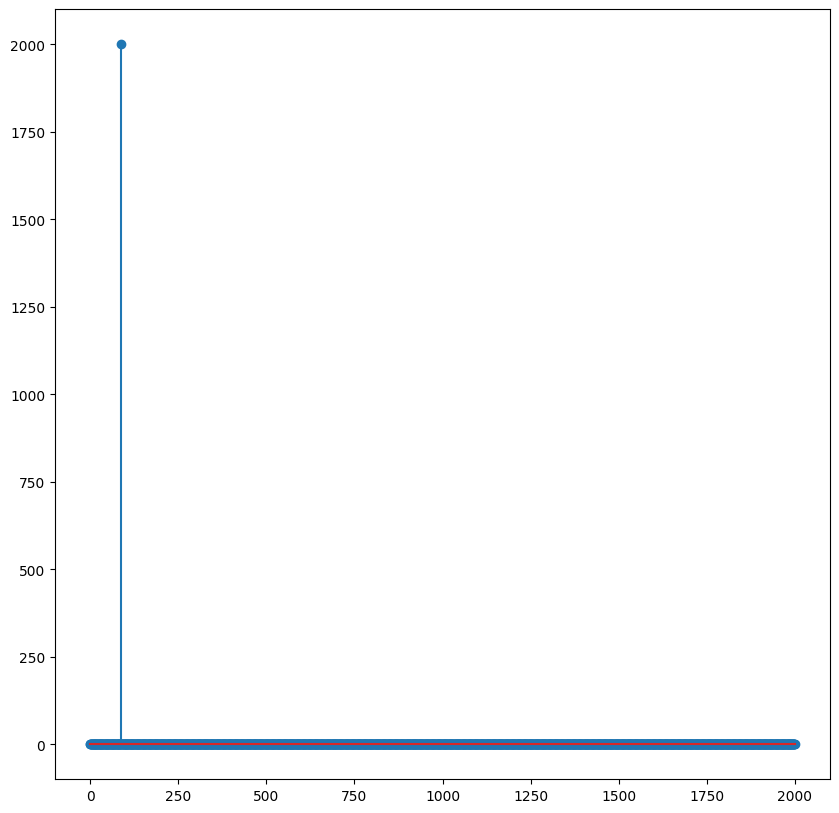

In [25]:
N = interfero.shape[1]
n = np.arange(0,N)
# create a pure wave using the previously computed frequency freq
onde = np.exp(1j*2*math.pi*freq[0]*n/N)
fonde = np.abs(np.fft.fft(onde))
plt.figure()
plt.stem(fonde)
plt.show()

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


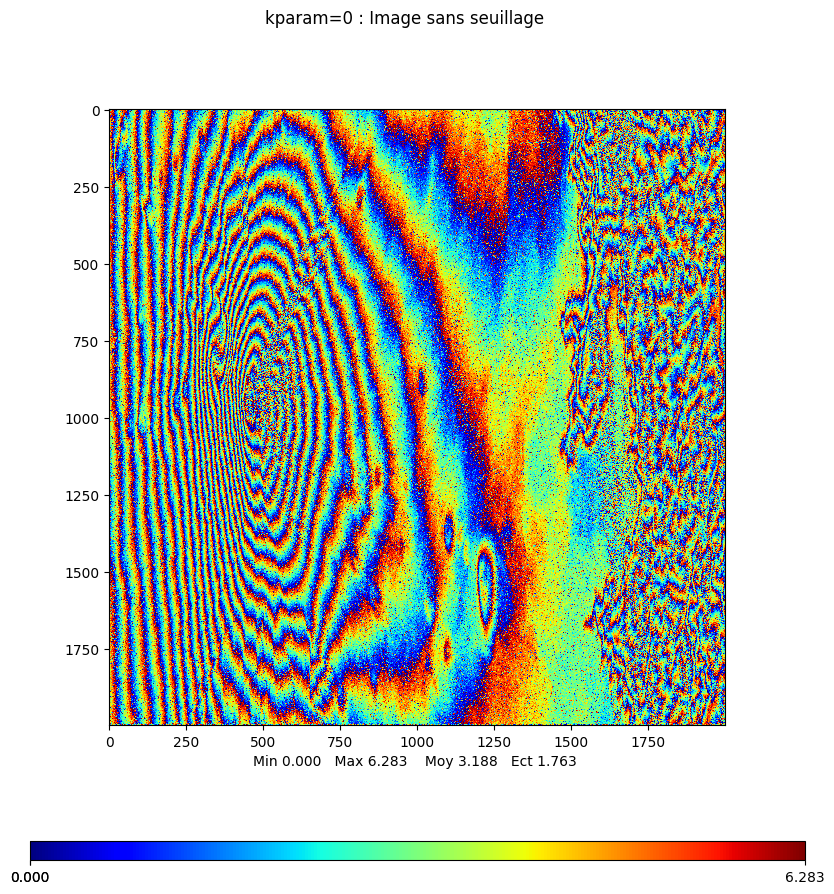

array([[4.22205732, 4.43748877, 4.63279904, ..., 1.66410967, 5.79580097,
        1.38671852],
       [4.88475065, 4.09426316, 4.16775586, ..., 0.53537511, 0.43898799,
        1.50581506],
       [4.49176528, 4.37331933, 3.95940709, ..., 3.79650517, 1.23606301,
        1.93147364],
       ...,
       [3.68611537, 4.05979031, 4.10318633, ..., 3.84287779, 4.27121875,
        4.37904306],
       [0.56173994, 5.61947585, 4.03621556, ..., 2.12344973, 2.65461342,
        5.49483413],
       [0.1502983 , 4.90681637, 5.3410586 , ..., 2.77876905, 0.61176229,
        1.23576357]])

In [26]:
# suppress the pattern by multiplying the interferogram by the conjugate of the pure wave
interferofine= np.multiply(interfero, onde.conj())

mvalab.visuinterfero(np.angle(interferofine)+math.pi,0)

### Answer 3.5b
We no longet have the vertical fringes. We obtain topographic fringes, they are wider in the side of the volacno that is not facing the sensor, and they are narrower on the side that is facing the sensor.

### Question 3.6: interferogram filtering
To improve the quality of the interferogram, some filtering can be applied to reduce the phase noise. Propose a suitable kernel by filling the code below.

How does the filtered interferogram look like?

### Answer 3.6
We can use a simple averaging kernel to smooth out the noisy interferogram.

In [27]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase
    is the interferometric phase.
    """

    dimx=3
    dimy=3

    if(len(therest)==1):
        dimx=therest[0]
        dimy=dimx

    if(len(therest)==2):
        dimx=therest[0]
        dimy=therest[1]

    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)

    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0

    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0

    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window


    mask = np.ones((dimx,dimy))/(dimx*dimy) # mask to average the phase
    interfiltr = signal.convolve2d(interf,mask,mode='same')

    den1 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette)),mask,mode='same'))
    den2 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette2)),mask,mode='same'))

    return interfiltr/(den1*den2+1e-12)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


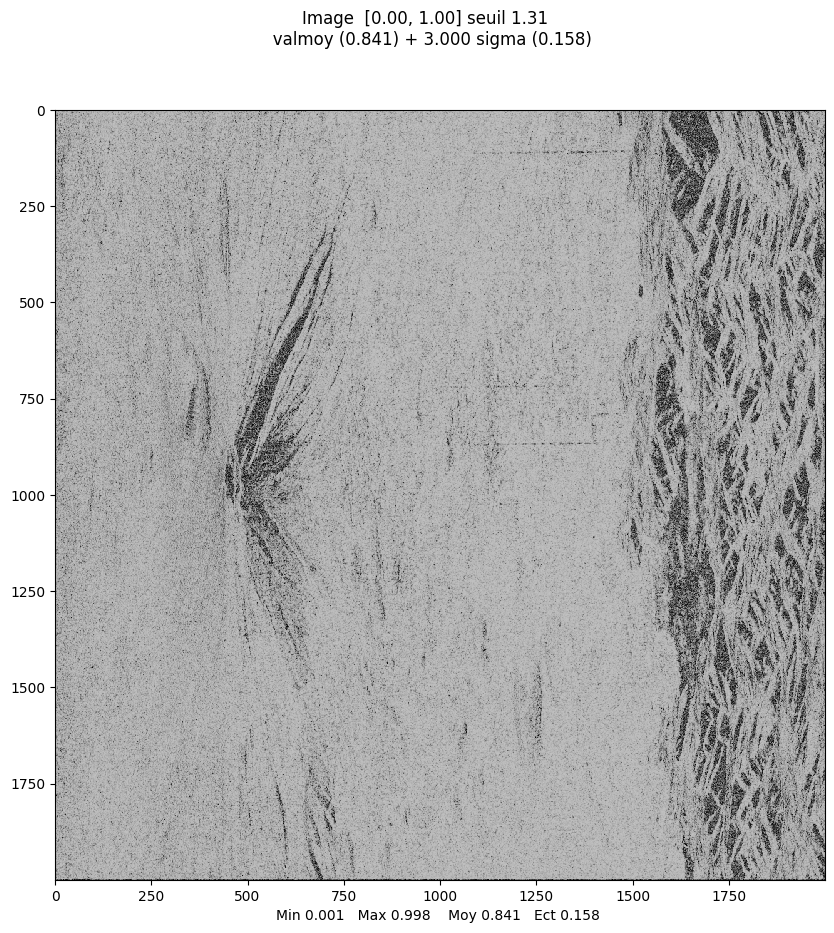

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


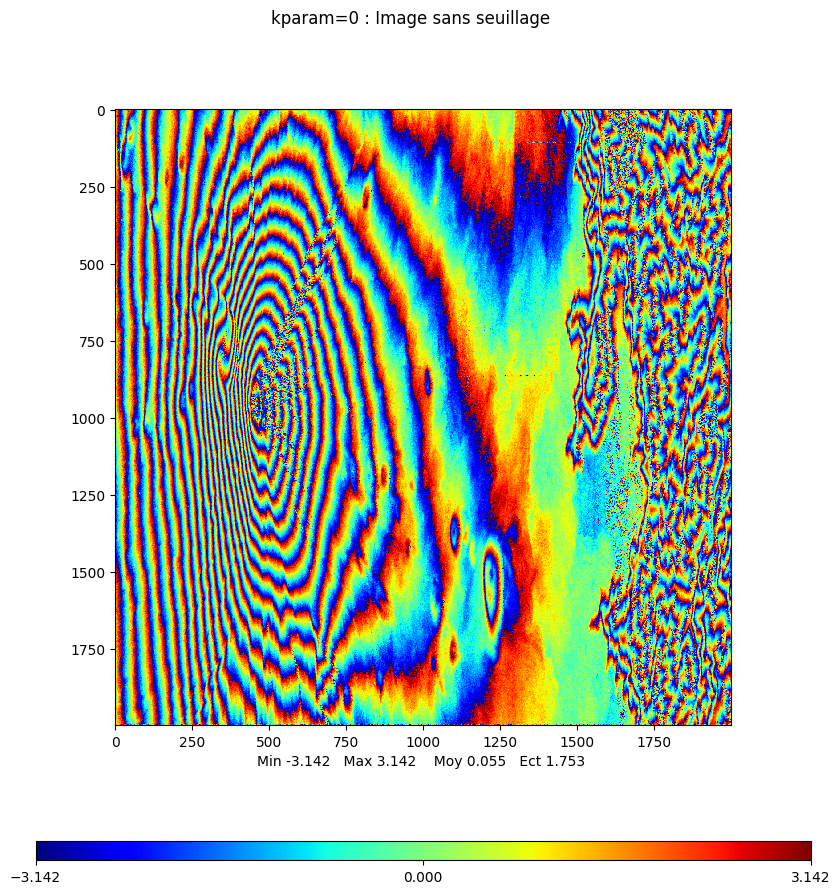

array([[ 1.22928435,  1.22189314,  1.66339952, ..., -2.48271499,
        -2.29888435, -2.21416634],
       [ 1.25949506,  1.22627493,  1.5226385 , ..., -2.44594552,
        -2.12710992, -2.00153212],
       [ 1.49187687,  1.41348907,  1.4640586 , ..., -2.63013027,
        -2.36358314, -2.12655164],
       ...,
       [ 1.13273685,  1.06872398,  1.1560881 , ...,  0.1104342 ,
         0.67959699,  1.86228863],
       [ 2.47672456,  2.29509197,  1.46388233, ..., -0.02889894,
        -0.96649899, -2.93866588],
       [ 3.06275392,  2.9126104 ,  2.11403226, ..., -0.25149618,
        -1.22497276, -2.57826352]])

In [28]:
imaslavefine= np.multiply(imaslaveroll,onde)
filtered_interferogram = interferogramme(imamaitre,imaslavefine)
mvalab.visusar(np.abs(filtered_interferogram))
mvalab.visuinterfero(np.angle(filtered_interferogram),0)

### Question 3.7
Can you apply the convolution directly on the interferometric phase image ?
What would happen in that case?

We shouldn't apply convolution directly on the interferometric phase image, because if we do that we would lose information because of the periodicity of the phase.